In [2]:
pip install numpy opencv-python networkx scikit-image

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 67.0/67.0 MB 50.5 MB/s  0:00:01 eta 0:00:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 16.5/16.5 MB 24.3 MB/s  0:00:00 eta 0:00:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.1/2.1 MB 33.6 MB/s  0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.7/13.7 MB 20.3 MB/s  0:00:00 eta 0:00:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.0/7.0 MB 50.0 MB/s  0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 35.7/35.7 MB 45.3 MB/s  0:00:00 eta 0:00:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 9/9 [scikit-image] [scikit-image]]
Note: you may need to restart the kernel to use updated packages.


In [2]:
from __future__ import annotations

from typing import Any, Dict, Iterable, List, Optional, Tuple, Union
import json
import math

import numpy as np
import cv2
import networkx as nx

from skimage.morphology import skeletonize  # pip install scikit-image


# ============================================================
# 1) Carga / normalización de entradas
# ============================================================

def load_pgm_gray(pgm_path: str, *, invert: bool = False) -> np.ndarray:
    """
    Carga una imagen PGM (o compatible) en escala de grises a numpy.

    Parámetros
    ----------
    pgm_path : str
        Ruta del fichero .pgm.
    invert : bool
        Si True, invierte intensidades (255 - img). Útil si tu convención está invertida.

    Retorna
    -------
    img : np.ndarray (H,W) uint8
        Intensidades 0..255.
    """
    img = cv2.imread(pgm_path, cv2.IMREAD_GRAYSCALE)
    if img is None:
        raise FileNotFoundError(f"No se pudo leer el PGM: {pgm_path}")
    if invert:
        img = 255 - img
    return img.astype(np.uint8, copy=False)


def occupancygrid_dict_to_numpy(
    occ: Dict[str, Any],
) -> Tuple[np.ndarray, Dict[str, Any]]:
    """
    Convierte un dict con el esquema típico de nav_msgs/OccupancyGrid a numpy.

    Esquema esperado (mínimo):
    occ = {
      "header": {"frame_id": "map", ...},
      "info": {"width": W, "height": H, "resolution": res,
               "origin": {"position": {"x": x0, "y": y0}}},
      "data": [...]  # longitud H*W, valores -1..100
    }

    Retorna
    -------
    grid : np.ndarray (H,W) int16
        Valores -1..100 (unknown=-1).
    meta : dict
        {"width","height","resolution","origin_xy","frame_id"}
    """
    info = occ["info"]
    w, h = int(info["width"]), int(info["height"])
    res = float(info["resolution"])
    origin = info.get("origin", {}).get("position", {})
    x0, y0 = float(origin.get("x", 0.0)), float(origin.get("y", 0.0))
    frame_id = occ.get("header", {}).get("frame_id", "map")

    grid = np.array(occ["data"], dtype=np.int16).reshape((h, w))
    meta = {"width": w, "height": h, "resolution": res, "origin_xy": (x0, y0), "frame_id": frame_id}
    return grid, meta


# ============================================================
# 2) Binzarización (PGM / OccupancyGrid) -> free/obst/unknown
# ============================================================

def pgm_to_binary_masks(
    img: np.ndarray,
    *,
    free_threshold: int = 200,
    occ_threshold: int = 50,
    treat_mid_as_unknown: bool = True,
    unknown_is_obstacle: bool = True,
) -> Dict[str, np.ndarray]:
    """
    Convierte PGM (0..255) a máscaras binarias.

    Convención típica:
    - oscuro => obstáculo
    - claro  => libre
    - intermedio => unknown (opcional)

    Parámetros
    ----------
    img : np.ndarray (H,W) uint8
    free_threshold : int
        Intensidad >= free_threshold se considera libre.
    occ_threshold : int
        Intensidad <= occ_threshold se considera obstáculo.
    treat_mid_as_unknown : bool
        Si True, el rango intermedio se marca como unknown.
    unknown_is_obstacle : bool
        Si True, unknown se trata como obstáculo (política conservadora).

    Retorna
    -------
    masks : dict
        {"free": bool(H,W), "obstacle": bool(H,W), "unknown": bool(H,W)}
    """
    img_i = img.astype(np.int16, copy=False)
    free = img_i >= free_threshold
    obstacle = img_i <= occ_threshold
    if treat_mid_as_unknown:
        unknown = ~(free | obstacle)
    else:
        unknown = np.zeros_like(free, dtype=bool)

    if unknown_is_obstacle:
        obstacle2 = obstacle | unknown
        free2 = ~obstacle2
        obstacle = obstacle2
        free = free2

    return {"free": free, "obstacle": obstacle, "unknown": unknown}


def occupancygrid_to_binary_masks(
    grid: np.ndarray,
    *,
    occ_threshold: int = 50,
    unknown_value: int = -1,
    unknown_is_obstacle: bool = True,
) -> Dict[str, np.ndarray]:
    """
    Convierte OccupancyGrid (-1,0..100) a máscaras binarias.

    Parámetros
    ----------
    grid : np.ndarray (H,W) int16
    occ_threshold : int
        grid >= occ_threshold => obstáculo.
    unknown_value : int
        Valor de unknown (por defecto -1).
    unknown_is_obstacle : bool
        Si True, unknown se trata como obstáculo.

    Retorna
    -------
    masks : dict
        {"free": bool(H,W), "obstacle": bool(H,W), "unknown": bool(H,W)}
    """
    g = grid.astype(np.int16, copy=False)
    unknown = (g == unknown_value)
    obstacle = (g >= occ_threshold) | (unknown if unknown_is_obstacle else False)
    free = ~obstacle
    return {"free": free, "obstacle": obstacle, "unknown": unknown}


# ============================================================
# 3) Distance Transform (eficiente) y skeleton
# ============================================================

def compute_distance_transform_l2(
    free_mask: np.ndarray,
    *,
    use_precise: bool = True,
) -> np.ndarray:
    """
    Calcula el Distance Transform L2: distancia al píxel 'cero' más cercano.

    OpenCV define distanceTransform como distancia de cada píxel binario al cero más cercano. :contentReference[oaicite:6]{index=6}

    Parámetros
    ----------
    free_mask : np.ndarray (H,W) bool
        True donde es libre. Internamente se convierte a uint8 con 255 (no-cero) para free y 0 para obstáculo.
    use_precise : bool
        Si True usa DIST_MASK_PRECISE (más exacto; en L2 puede ir paralelizado con TBB). :contentReference[oaicite:7]{index=7}

    Retorna
    -------
    dist : np.ndarray (H,W) float32
        Distancias en unidades de celda (multiplica por resolution para metros).
    """
    src = (free_mask.astype(np.uint8) * 255)
    mask = cv2.DIST_MASK_PRECISE if use_precise else 3
    dist = cv2.distanceTransform(src, cv2.DIST_L2, mask)
    return dist


def compute_skeleton_free_space(
    free_mask: np.ndarray,
) -> np.ndarray:
    """
    Extrae un esqueleto 1-píxel del espacio libre (proxy del GVD discreto).

    skeletonize reduce un objeto binario a 1 píxel de ancho preservando conectividad (thinning iterativo). :contentReference[oaicite:8]{index=8}

    Parámetros
    ----------
    free_mask : np.ndarray (H,W) bool

    Retorna
    -------
    skel : np.ndarray (H,W) bool
    """
    return skeletonize(free_mask).astype(bool, copy=False)


# ============================================================
# 4) Skeleton -> Grafo NetworkX (nodos/aristas)
# ============================================================

def _neighbors8(r: int, c: int) -> Iterable[Tuple[int, int]]:
    for dr in (-1, 0, 1):
        for dc in (-1, 0, 1):
            if dr == 0 and dc == 0:
                continue
            yield r + dr, c + dc


def skeleton_degree_map(skel: np.ndarray) -> np.ndarray:
    """
    Grado (vecindad 8) de cada píxel del skeleton: nº de vecinos skeleton.

    Retorna
    -------
    deg : np.ndarray (H,W) uint8
    """
    sk = skel.astype(np.uint8)
    kernel = np.array([[1,1,1],[1,0,1],[1,1,1]], dtype=np.uint8)
    return cv2.filter2D(sk, -1, kernel, borderType=cv2.BORDER_CONSTANT)


def skeleton_to_nx_graph(
    skel: np.ndarray,
    *,
    resolution_m: float = 1.0,
    origin_xy_m: Tuple[float, float] = (0.0, 0.0),
    frame_id: str = "map",
    deg_min_junction: int = 3,
    include_endpoints: bool = True,
) -> nx.Graph:
    """
    Convierte un skeleton binario a un grafo topológico (NetworkX).

    Nodos:
    - endpoints (deg==1) si include_endpoints
    - intersecciones (deg>=deg_min_junction)

    Aristas:
    - se trazan siguiendo píxeles de grado 2 hasta conectar nodos.
    - se guarda la geometría como lista de celdas (path_cells).

    NetworkX permite nodos/aristas con atributos arbitrarios (ideal para etiquetas/metrics). :contentReference[oaicite:9]{index=9}

    Parámetros
    ----------
    skel : np.ndarray (H,W) bool
    resolution_m, origin_xy_m, frame_id : metadatos para convertir celda->mundo
    deg_min_junction : int
    include_endpoints : bool

    Retorna
    -------
    G : nx.Graph
    """
    H, W = skel.shape
    deg = skeleton_degree_map(skel)
    sk = skel.astype(bool)

    def cell_to_xy(rc: Tuple[int,int]) -> Tuple[float,float]:
        r, c = rc
        x0, y0 = origin_xy_m
        return (x0 + c * resolution_m, y0 + r * resolution_m)

    # 1) seleccionar nodos
    node_cells: List[Tuple[int,int]] = []
    ys, xs = np.where(sk)
    for r, c in zip(ys.tolist(), xs.tolist()):
        d = int(deg[r, c])
        if (include_endpoints and d == 1) or (d >= deg_min_junction):
            node_cells.append((r, c))

    # index
    node_id = {rc: f"n{i}" for i, rc in enumerate(node_cells)}
    node_set = set(node_id.keys())

    # 2) construir grafo
    G = nx.Graph(frame_id=frame_id, resolution_m=resolution_m, origin_xy_m=origin_xy_m)

    for rc, nid in node_id.items():
        x, y = cell_to_xy(rc)
        d = int(deg[rc[0], rc[1]])
        ntype = "junction" if d >= deg_min_junction else "endpoint"
        G.add_node(nid, cell=rc, xy_m=(x, y), type=ntype, labels={})

    # 3) trazar aristas
    visited_directed = set()

    def valid(rc: Tuple[int,int]) -> bool:
        r, c = rc
        return 0 <= r < H and 0 <= c < W and sk[r, c]

    def nbrs(rc: Tuple[int,int]) -> List[Tuple[int,int]]:
        r, c = rc
        out = []
        for rr, cc in _neighbors8(r, c):
            if 0 <= rr < H and 0 <= cc < W and sk[rr, cc]:
                out.append((rr, cc))
        return out

    for u_rc, u in node_id.items():
        for v_rc in nbrs(u_rc):
            if (u_rc, v_rc) in visited_directed:
                continue

            path = [u_rc]
            prev = u_rc
            curr = v_rc
            visited_directed.add((u_rc, v_rc))

            while True:
                path.append(curr)
                if curr in node_set:
                    v = node_id[curr]
                    if u != v:
                        # guardamos una arista (u,v) con path_cells (polilínea en grid)
                        if not G.has_edge(u, v):
                            G.add_edge(u, v, path_cells=path, labels={}, metrics={})
                    break

                nlist = nbrs(curr)
                if not nlist:
                    break
                nxt = None
                for cand in nlist:
                    if cand != prev:
                        nxt = cand
                        break
                if nxt is None:
                    break
                visited_directed.add((prev, curr))
                prev, curr = curr, nxt

    return G


# ============================================================
# 5) Line-of-sight (segmentos rectos) + métricas
# ============================================================

def bresenham_line(a: Tuple[int,int], b: Tuple[int,int]) -> Iterable[Tuple[int,int]]:
    """Bresenham discreto (r,c) para raycasting en grid."""
    r0, c0 = a
    r1, c1 = b
    dr = abs(r1 - r0)
    dc = abs(c1 - c0)
    sr = 1 if r0 < r1 else -1
    sc = 1 if c0 < c1 else -1
    err = dr - dc

    r, c = r0, c0
    while True:
        yield (r, c)
        if r == r1 and c == c1:
            break
        e2 = 2 * err
        if e2 > -dc:
            err -= dc
            r += sr
        if e2 < dr:
            err += dr
            c += sc


def segment_is_free(
    free_mask: np.ndarray,
    a_rc: Tuple[int,int],
    b_rc: Tuple[int,int],
    *,
    dist: Optional[np.ndarray] = None,
    min_clearance_cells: float = 0.0,
) -> bool:
    """
    Comprueba si el segmento a->b es navegable en el grid (línea recta).

    Parámetros
    ----------
    free_mask : bool(H,W)
    dist : float(H,W) o None
        Distance transform en celdas. Solo necesario si min_clearance_cells > 0.
    min_clearance_cells : float
        Exige dist[r,c] >= min_clearance_cells en cada celda del segmento.

    Retorna
    -------
    ok : bool
    """
    if min_clearance_cells > 0 and dist is None:
        raise ValueError("min_clearance_cells > 0 requiere 'dist'.")

    for r, c in bresenham_line(a_rc, b_rc):
        if not free_mask[r, c]:
            return False
        if dist is not None and dist[r, c] < min_clearance_cells:
            return False
    return True


def enrich_graph_metrics(
    G: nx.Graph,
    *,
    dist: Optional[np.ndarray] = None,
) -> None:
    """
    Añade métricas a aristas:
    - length_m (por suma de segmentos en path_cells)
    - min_clearance_m (mínimo dist a lo largo de path_cells) si dist disponible

    Modifica G in-place.
    """
    res = float(G.graph.get("resolution_m", 1.0))
    for u, v, data in G.edges(data=True):
        path = data.get("path_cells", [])
        if len(path) < 2:
            data.setdefault("metrics", {})["length_m"] = 0.0
            continue

        length_cells = 0.0
        min_c = None
        for (r0,c0), (r1,c1) in zip(path[:-1], path[1:]):
            length_cells += math.hypot(r1 - r0, c1 - c0)
            if dist is not None:
                d0 = float(dist[r0, c0])
                min_c = d0 if min_c is None else min(min_c, d0)

        metrics = data.setdefault("metrics", {})
        metrics["length_m"] = float(length_cells * res)
        if dist is not None and min_c is not None:
            metrics["min_clearance_m"] = float(min_c * res)


def mark_edges_line_of_sight(
    G: nx.Graph,
    free_mask: np.ndarray,
    *,
    dist: Optional[np.ndarray] = None,
    min_clearance_m: float = 0.0,
    keep_polyline_if_not_los: bool = True,
) -> None:
    """
    Intenta convertir cada arista a un segmento recto entre sus nodos.

    - Si LOS válido: data["is_straight"]=True y data["geometry"]={"segment_xy_m":[(x1,y1),(x2,y2)]}
    - Si no: 
        * keep_polyline_if_not_los=True -> is_straight=False, geometry guarda polyline_cells
        * False -> data["enabled"]=False (para filtrado posterior)

    Parámetros
    ----------
    dist : float(H,W) o None
    min_clearance_m : float
        Clearance mínimo en metros a lo largo del segmento.
    keep_polyline_if_not_los : bool
    """
    res = float(G.graph.get("resolution_m", 1.0))
    min_clearance_cells = (min_clearance_m / res) if min_clearance_m > 0 else 0.0

    for u, v, data in G.edges(data=True):
        a_rc = G.nodes[u]["cell"]
        b_rc = G.nodes[v]["cell"]

        ok = segment_is_free(
            free_mask, a_rc, b_rc,
            dist=dist,
            min_clearance_cells=min_clearance_cells
        )

        data["enabled"] = True
        data["is_straight"] = bool(ok)

        if ok:
            ax, ay = G.nodes[u]["xy_m"]
            bx, by = G.nodes[v]["xy_m"]
            data["geometry"] = {"segment_xy_m": [(ax, ay), (bx, by)]}
        else:
            if keep_polyline_if_not_los:
                data["geometry"] = {"polyline_cells": data.get("path_cells", [])}
            else:
                data["enabled"] = False


# ============================================================
# 6) Etiquetado por rectángulos (tu diccionario de espacios)
# ============================================================

def label_nodes_by_rectangles(
    G: nx.Graph,
    rects: List[Dict[str, Any]],
    *,
    label_key: str = "space",
    priority: str = "first",
) -> None:
    """
    Etiqueta nodos en función de rectángulos en coordenadas de celda.

    rects: lista de:
      {"label": "kitchen", "start_rc": (r0,c0), "h": 40, "w": 60}

    Parámetros
    ----------
    label_key : str
        Clave donde guardar la etiqueta (en node["labels"][label_key]).
    priority : {"first","last","all"}
        first: asigna la primera coincidencia si no hay etiqueta previa
        last: sobrescribe con la última coincidencia
        all: guarda lista de todas las coincidencias
    """
    def contains(rc: Tuple[int,int], rect: Dict[str,Any]) -> bool:
        r, c = rc
        r0, c0 = rect["start_rc"]
        h, w = int(rect["h"]), int(rect["w"])
        return (r0 <= r < r0 + h) and (c0 <= c < c0 + w)

    for nid, nd in G.nodes(data=True):
        rc = nd["cell"]
        matches = [r["label"] for r in rects if contains(rc, r)]
        if not matches:
            continue

        labels = nd.setdefault("labels", {})
        if priority == "first":
            labels.setdefault(label_key, matches[0])
        elif priority == "last":
            labels[label_key] = matches[-1]
        elif priority == "all":
            labels[label_key] = matches
        else:
            raise ValueError("priority debe ser: 'first', 'last' o 'all'.")


# ============================================================
# 7) Export a JSON para LLM
# ============================================================

def nx_graph_to_llm_json(
    G: nx.Graph,
    *,
    include_disabled_edges: bool = False,
) -> str:
    """
    Serializa el grafo NetworkX a un JSON LLM-friendly.

    Incluye:
    - metadatos (frame, resolution, origin)
    - nodos con atributos
    - aristas con atributos (filtrando enabled=False si aplica)

    NetworkX permite atributos arbitrarios; aquí solo los “volcamos”. :contentReference[oaicite:10]{index=10}
    """
    payload = {
        "frame": G.graph.get("frame_id", "map"),
        "resolution_m": G.graph.get("resolution_m", 1.0),
        "origin_xy_m": list(G.graph.get("origin_xy_m", (0.0, 0.0))),
        "nodes": [],
        "edges": []
    }

    for nid, nd in G.nodes(data=True):
        node_out = {"id": nid, **nd}
        # Tuplas a listas para JSON
        if "cell" in node_out:
            node_out["cell"] = [int(node_out["cell"][0]), int(node_out["cell"][1])]
        if "xy_m" in node_out:
            node_out["xy_m"] = [float(node_out["xy_m"][0]), float(node_out["xy_m"][1])]
        payload["nodes"].append(node_out)

    for u, v, ed in G.edges(data=True):
        if not include_disabled_edges and ed.get("enabled") is False:
            continue
        edge_out = {"from": u, "to": v, **ed}
        payload["edges"].append(edge_out)

    return json.dumps(payload, ensure_ascii=False, indent=2)


In [3]:
from __future__ import annotations

from typing import Any, Dict, List, Optional, Tuple
import numpy as np
import matplotlib.pyplot as plt
import networkx as nx


# ============================================================
# A) Utilidades de visualización base
# ============================================================

def show_gray(
    img: np.ndarray,
    *,
    title: str = "Grayscale",
    figsize: Tuple[int, int] = (7, 7),
    vmin: Optional[float] = None,
    vmax: Optional[float] = None,
) -> None:
    """
    Muestra una imagen en escala de grises.

    Parámetros
    ----------
    img : np.ndarray (H,W)
    title : str
    figsize : (w,h)
    vmin, vmax : float | None
        Rango de visualización (si None, auto).
    """
    plt.figure(figsize=figsize)
    plt.imshow(img, cmap="gray", vmin=vmin, vmax=vmax)
    plt.title(title)
    plt.axis("off")
    plt.show()


def show_bool_mask(
    mask: np.ndarray,
    *,
    title: str = "Mask",
    figsize: Tuple[int, int] = (7, 7),
) -> None:
    """
    Muestra una máscara booleana (True/False).
    """
    show_gray(mask.astype(np.uint8) * 255, title=title, figsize=figsize, vmin=0, vmax=255)


def show_two_masks(
    mask_a: np.ndarray,
    mask_b: np.ndarray,
    *,
    title_a: str = "Mask A",
    title_b: str = "Mask B",
    figsize: Tuple[int, int] = (12, 6),
) -> None:
    """
    Muestra dos máscaras lado a lado.
    """
    plt.figure(figsize=figsize)
    plt.subplot(1, 2, 1)
    plt.imshow(mask_a.astype(np.uint8) * 255, cmap="gray", vmin=0, vmax=255)
    plt.title(title_a)
    plt.axis("off")

    plt.subplot(1, 2, 2)
    plt.imshow(mask_b.astype(np.uint8) * 255, cmap="gray", vmin=0, vmax=255)
    plt.title(title_b)
    plt.axis("off")
    plt.show()


def show_distance_transform(
    dist: np.ndarray,
    *,
    title: str = "Distance Transform (cells)",
    figsize: Tuple[int, int] = (7, 7),
    percentile_clip: Tuple[float, float] = (1.0, 99.0),
) -> None:
    """
    Visualiza el distance transform con recorte robusto por percentiles.

    Parámetros
    ----------
    dist : np.ndarray (H,W) float
    percentile_clip : (p_low, p_high)
        Recorta el rango para evitar que 2-3 valores extremos “aplasten” el contraste.
    """
    d = dist.copy()
    lo, hi = np.percentile(d[np.isfinite(d)], list(percentile_clip))
    plt.figure(figsize=figsize)
    plt.imshow(d, vmin=lo, vmax=hi)
    plt.title(title)
    plt.axis("off")
    plt.colorbar(shrink=0.75)
    plt.show()


def show_overlay(
    base_gray: np.ndarray,
    overlay_mask: np.ndarray,
    *,
    title: str = "Overlay",
    figsize: Tuple[int, int] = (7, 7),
    alpha: float = 0.6,
) -> None:
    """
    Superpone una máscara (overlay_mask) sobre una imagen base en gris.
    """
    plt.figure(figsize=figsize)
    plt.imshow(base_gray, cmap="gray")
    plt.imshow(overlay_mask.astype(float), alpha=alpha)  # colormap default
    plt.title(title)
    plt.axis("off")
    plt.show()


# ============================================================
# B) Visualización específica del pipeline
# ============================================================

def preview_binary_masks(
    masks: Dict[str, np.ndarray],
    *,
    figsize: Tuple[int, int] = (18, 6),
) -> None:
    """
    Muestra free / obstacle / unknown (si existe) en una sola figura.
    """
    free = masks.get("free")
    obst = masks.get("obstacle")
    unk = masks.get("unknown")

    n = 3 if unk is not None else 2
    plt.figure(figsize=figsize)

    plt.subplot(1, n, 1)
    plt.imshow(free.astype(np.uint8) * 255, cmap="gray", vmin=0, vmax=255)
    plt.title("free")
    plt.axis("off")

    plt.subplot(1, n, 2)
    plt.imshow(obst.astype(np.uint8) * 255, cmap="gray", vmin=0, vmax=255)
    plt.title("obstacle")
    plt.axis("off")

    if unk is not None:
        plt.subplot(1, n, 3)
        plt.imshow(unk.astype(np.uint8) * 255, cmap="gray", vmin=0, vmax=255)
        plt.title("unknown")
        plt.axis("off")

    plt.show()


def preview_skeleton(
    base: np.ndarray,
    skel: np.ndarray,
    *,
    title: str = "Skeleton overlay",
    figsize: Tuple[int, int] = (7, 7),
    alpha: float = 0.7,
) -> None:
    """
    Muestra el skeleton superpuesto sobre una base (PGM o una máscara libre).
    """
    base_gray = base
    if base_gray.dtype == bool:
        base_gray = base_gray.astype(np.uint8) * 255
    show_overlay(base_gray, skel, title=title, figsize=figsize, alpha=alpha)


def preview_graph_nodes_edges_on_grid(
    base: np.ndarray,
    G: nx.Graph,
    *,
    title: str = "Graph on grid",
    figsize: Tuple[int, int] = (8, 8),
    draw_labels: bool = False,
) -> None:
    """
    Dibuja el grafo (nodos y aristas) superpuesto sobre un grid (imagen base).

    - Nodos: puntos
    - Aristas: si hay path_cells (polilínea) dibuja esa polilínea; si no, dibuja segmento entre nodos.

    Parámetros
    ----------
    base : np.ndarray (H,W)
        Imagen base (PGM uint8, o máscara en bool).
    draw_labels : bool
        Si True, dibuja id del nodo (puede saturar si hay muchos).
    """
    base_gray = base
    if base_gray.dtype == bool:
        base_gray = base_gray.astype(np.uint8) * 255

    plt.figure(figsize=figsize)
    plt.imshow(base_gray, cmap="gray")
    plt.title(title)
    plt.axis("off")

    # Aristas
    for u, v, data in G.edges(data=True):
        # preferencia: polilínea en grid
        path = data.get("path_cells")
        if path and len(path) >= 2:
            rr = [rc[0] for rc in path]
            cc = [rc[1] for rc in path]
            plt.plot(cc, rr)  # x=col, y=row
        else:
            r0, c0 = G.nodes[u]["cell"]
            r1, c1 = G.nodes[v]["cell"]
            plt.plot([c0, c1], [r0, r1])

    # Nodos
    for nid, nd in G.nodes(data=True):
        r, c = nd["cell"]
        plt.scatter([c], [r], s=20)
        if draw_labels:
            plt.text(c + 1, r + 1, nid, fontsize=8)

    plt.show()


def preview_graph_straight_edges_only(
    base: np.ndarray,
    G: nx.Graph,
    *,
    title: str = "Straight (LOS) edges",
    figsize: Tuple[int, int] = (8, 8),
) -> None:
    """
    Visualiza solo las aristas rectas (is_straight=True) sobre el grid.
    """
    base_gray = base
    if base_gray.dtype == bool:
        base_gray = base_gray.astype(np.uint8) * 255

    plt.figure(figsize=figsize)
    plt.imshow(base_gray, cmap="gray")
    plt.title(title)
    plt.axis("off")

    # aristas LOS
    for u, v, data in G.edges(data=True):
        if data.get("enabled") is False:
            continue
        if not data.get("is_straight", False):
            continue
        r0, c0 = G.nodes[u]["cell"]
        r1, c1 = G.nodes[v]["cell"]
        plt.plot([c0, c1], [r0, r1])

    # nodos
    for _, nd in G.nodes(data=True):
        r, c = nd["cell"]
        plt.scatter([c], [r], s=20)

    plt.show()


def preview_node_labels(
    base: np.ndarray,
    G: nx.Graph,
    *,
    label_key: str = "space",
    title: str = "Node labels",
    figsize: Tuple[int, int] = (10, 10),
) -> None:
    """
    Visualiza nodos y escribe su etiqueta (label_key) al lado.

    Útil para validar tu diccionario de rectángulos.
    """
    base_gray = base
    if base_gray.dtype == bool:
        base_gray = base_gray.astype(np.uint8) * 255

    plt.figure(figsize=figsize)
    plt.imshow(base_gray, cmap="gray")
    plt.title(title)
    plt.axis("off")

    for nid, nd in G.nodes(data=True):
        r, c = nd["cell"]
        lbl = nd.get("labels", {}).get(label_key)
        plt.scatter([c], [r], s=20)
        if lbl is not None:
            plt.text(c + 2, r + 2, str(lbl), fontsize=8)

    plt.show()


# ============================================================
# C) Inspección rápida (texto) de estructuras
# ============================================================

def summarize_masks(masks: Dict[str, np.ndarray]) -> Dict[str, Any]:
    """
    Devuelve estadísticas rápidas (counts) de las máscaras.
    """
    out = {}
    for k, m in masks.items():
        if m is None:
            continue
        out[k] = {
            "count_true": int(m.sum()),
            "count_false": int(m.size - m.sum()),
            "ratio_true": float(m.mean()),
            "shape": tuple(m.shape),
            "dtype": str(m.dtype),
        }
    return out


def summarize_graph(G: nx.Graph, *, top_k: int = 10) -> Dict[str, Any]:
    """
    Resumen rápido del grafo para depuración.
    """
    n = G.number_of_nodes()
    e = G.number_of_edges()
    degs = [d for _, d in G.degree()]
    out = {
        "nodes": n,
        "edges": e,
        "avg_degree": float(np.mean(degs)) if degs else 0.0,
        "max_degree": int(np.max(degs)) if degs else 0,
        "min_degree": int(np.min(degs)) if degs else 0,
        "graph_attrs": dict(G.graph),
    }

    # top nodos por grado
    top = sorted(G.degree(), key=lambda x: x[1], reverse=True)[:top_k]
    out["top_nodes_by_degree"] = [{"id": nid, "deg": int(d)} for nid, d in top]
    return out





In [4]:
img = load_pgm_gray("willow-2010-02-18-0.10.pgm", invert=False)

masks = pgm_to_binary_masks(
    img,
    free_threshold=200,
    occ_threshold=50,
    treat_mid_as_unknown=True,
    unknown_is_obstacle=True
)

dist = compute_distance_transform_l2(masks["free"], use_precise=True)  # OpenCV :contentReference[oaicite:11]{index=11}
skel = compute_skeleton_free_space(masks["free"])                      # skimage :contentReference[oaicite:12]{index=12}

G = skeleton_to_nx_graph(
    skel,
    resolution_m=0.05,
    origin_xy_m=(0.0, 0.0),
    frame_id="map",
    deg_min_junction=3,
    include_endpoints=True
)

enrich_graph_metrics(G, dist=dist)
mark_edges_line_of_sight(G, masks["free"], dist=dist, min_clearance_m=0.20, keep_polyline_if_not_los=True)

rects = [
    {"label": "kitchen", "start_rc": (50, 80), "h": 120, "w": 160},
    {"label": "corridor", "start_rc": (10, 10), "h": 60, "w": 300},
]
label_nodes_by_rectangles(G, rects, label_key="space", priority="first")

json_str = nx_graph_to_llm_json(G)
print(json_str)


{
  "frame": "map",
  "resolution_m": 0.05,
  "origin_xy_m": [
    0.0,
    0.0
  ],
  "nodes": [
    {
      "id": "n0",
      "cell": [
        1,
        166
      ],
      "xy_m": [
        8.3,
        0.05
      ],
      "type": "junction",
      "labels": {}
    },
    {
      "id": "n1",
      "cell": [
        1,
        167
      ],
      "xy_m": [
        8.35,
        0.05
      ],
      "type": "junction",
      "labels": {}
    },
    {
      "id": "n2",
      "cell": [
        1,
        168
      ],
      "xy_m": [
        8.4,
        0.05
      ],
      "type": "junction",
      "labels": {}
    },
    {
      "id": "n3",
      "cell": [
        1,
        172
      ],
      "xy_m": [
        8.6,
        0.05
      ],
      "type": "junction",
      "labels": {}
    },
    {
      "id": "n4",
      "cell": [
        1,
        173
      ],
      "xy_m": [
        8.65,
        0.05
      ],
      "type": "junction",
      "labels": {}
    },
    {
      "id": "n5",
 

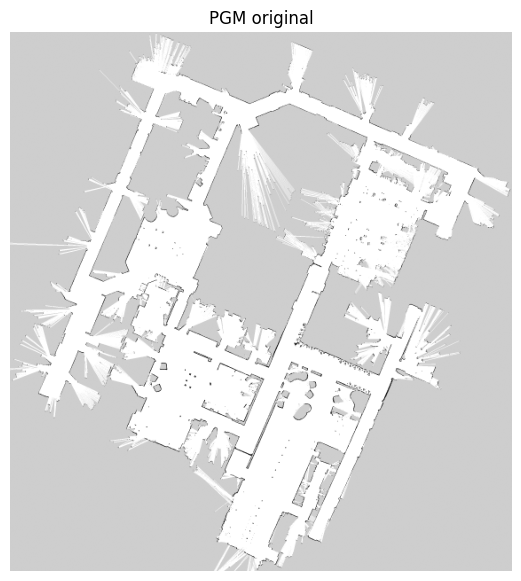

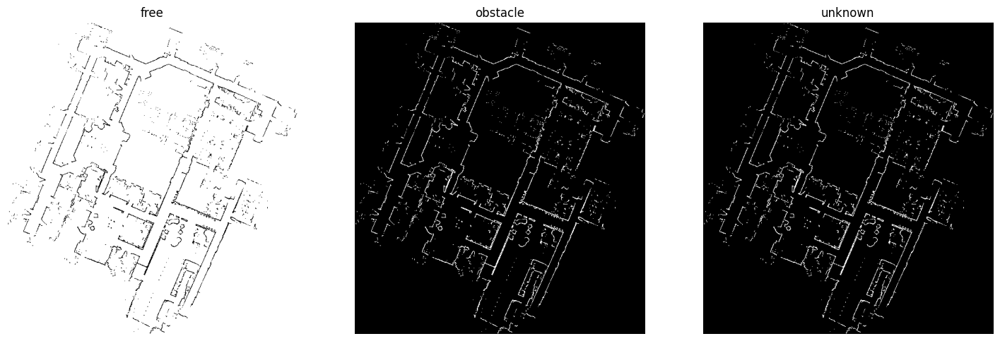

{'free': {'count_true': 334132, 'count_false': 9996, 'ratio_true': 0.9709526687744096, 'shape': (608, 566), 'dtype': 'bool'}, 'obstacle': {'count_true': 9996, 'count_false': 334132, 'ratio_true': 0.02904733122559048, 'shape': (608, 566), 'dtype': 'bool'}, 'unknown': {'count_true': 9903, 'count_false': 334225, 'ratio_true': 0.028777082945880602, 'shape': (608, 566), 'dtype': 'bool'}}


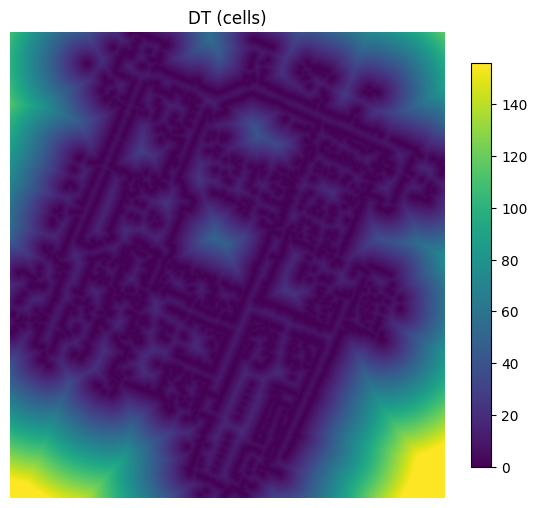

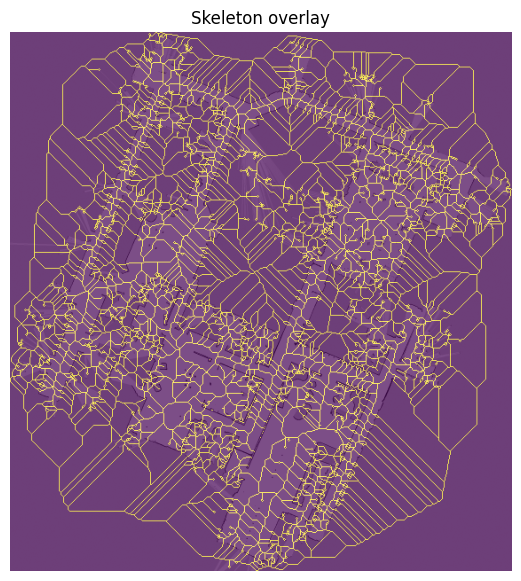

KeyboardInterrupt: 

In [ ]:
# ============================================================
# D) Ejemplo de uso (cómo ver cada paso)
# ============================================================

img = load_pgm_gray("willow-2010-02-18-0.10.pgm")
show_gray(img, title="PGM original")

masks = pgm_to_binary_masks(img)
preview_binary_masks(masks)
print(summarize_masks(masks))

dist = compute_distance_transform_l2(masks["free"])
show_distance_transform(dist, title="DT (cells)")

skel = compute_skeleton_free_space(masks["free"])
preview_skeleton(img, skel)

G = skeleton_to_nx_graph(skel, resolution_m=0.05, origin_xy_m=(0,0))
preview_graph_nodes_edges_on_grid(img, G, draw_labels=False)
print(summarize_graph(G))

enrich_graph_metrics(G, dist=dist)
mark_edges_line_of_sight(G, masks["free"], dist=dist, min_clearance_m=0.20)
preview_graph_straight_edges_only(img, G)

rects = [{"label":"kitchen", "start_rc": (50,80), "h": 120, "w": 160}]
label_nodes_by_rectangles(G, rects, label_key="space")
preview_node_labels(img, G, label_key="space")

In [5]:
import cv2
import numpy as np

def clean_free_mask(free: np.ndarray, *, open_iters=1, close_iters=1, kernel_size=3) -> np.ndarray:
    k = np.ones((kernel_size, kernel_size), np.uint8)
    x = free.astype(np.uint8) * 255
    if open_iters > 0:
        x = cv2.morphologyEx(x, cv2.MORPH_OPEN, k, iterations=open_iters)
    if close_iters > 0:
        x = cv2.morphologyEx(x, cv2.MORPH_CLOSE, k, iterations=close_iters)
    return (x > 0)

def keep_largest_component(mask: np.ndarray) -> np.ndarray:
    x = mask.astype(np.uint8)
    num, labels = cv2.connectedComponents(x)
    if num <= 1:
        return mask
    counts = np.bincount(labels.reshape(-1))
    counts[0] = 0  # fondo
    keep = counts.argmax()
    return (labels == keep)


In [7]:
def filter_skeleton_by_clearance(skel: np.ndarray, dist: np.ndarray, *, min_clearance_cells: float) -> np.ndarray:
    return skel & (dist >= min_clearance_cells)


In [12]:
def split_path_into_los_points(
    free_mask: np.ndarray,
    path_cells: List[Tuple[int,int]],
    *,
    dist: Optional[np.ndarray] = None,
    min_clearance_cells: float = 0.0,
) -> List[Tuple[int,int]]:
    """
    Devuelve una lista de 'puntos de quiebre' (celdas) para que cada tramo consecutivo tenga LOS.
    Incluye inicio y fin.
    """
    if len(path_cells) < 2:
        return path_cells

    def los(a, b) -> bool:
        return segment_is_free(free_mask, a, b, dist=dist, min_clearance_cells=min_clearance_cells)

    anchors = [path_cells[0]]
    i = 0
    n = len(path_cells)

    while i < n - 1:
        j_best = i + 1
        j = i + 1
        while j < n and los(path_cells[i], path_cells[j]):
            j_best = j
            j += 1
        anchors.append(path_cells[j_best])
        i = j_best

    return anchors


def replace_edges_with_los_chains(
    G: nx.Graph,
    free_mask: np.ndarray,
    *,
    dist: Optional[np.ndarray] = None,
    min_clearance_m: float = 0.0,
) -> nx.Graph:
    """
    Nuevo grafo donde cada arista queda reemplazada por una cadena de aristas LOS.
    Inserta nodos 'turn' donde haga falta. Mantiene conectividad.
    """
    res = float(G.graph.get("resolution_m", 1.0))
    origin = tuple(G.graph.get("origin_xy_m", (0.0, 0.0)))
    frame_id = G.graph.get("frame_id", "map")
    min_clearance_cells = (min_clearance_m / res) if min_clearance_m > 0 else 0.0

    def cell_to_xy(rc):
        r, c = rc
        x0, y0 = origin
        return (x0 + c * res, y0 + r * res)

    H = nx.Graph(frame_id=frame_id, resolution_m=res, origin_xy_m=origin)
    for nid, nd in G.nodes(data=True):
        H.add_node(nid, **nd)

    turn_id = 0
    def new_turn_id():
        nonlocal turn_id
        tid = f"t{turn_id}"
        turn_id += 1
        return tid

    for u, v, ed in G.edges(data=True):
        if ed.get("enabled") is False:
            continue
        path = ed.get("path_cells")
        if not path or len(path) < 2:
            continue

        anchors = split_path_into_los_points(
            free_mask, path, dist=dist, min_clearance_cells=min_clearance_cells
        )

        # anchors: [start_rc, ..., end_rc]
        chain_nodes = [u]
        # nodos intermedios
        for rc in anchors[1:-1]:
            tid = new_turn_id()
            H.add_node(tid, cell=rc, xy_m=cell_to_xy(rc), type="turn", labels={})
            chain_nodes.append(tid)
        chain_nodes.append(v)

        # aristas LOS
        for a, b in zip(chain_nodes[:-1], chain_nodes[1:]):
            ax, ay = H.nodes[a]["xy_m"]
            bx, by = H.nodes[b]["xy_m"]
            H.add_edge(
                a, b,
                enabled=True,
                is_straight=True,
                geometry={"segment_xy_m": [(ax, ay), (bx, by)]},
                labels={},
                metrics={}
            )

    return H


In [13]:
def snap_merge_nodes(
    G: nx.Graph,
    *,
    snap_radius_cells: int = 3
) -> nx.Graph:
    """
    Fusiona nodos cercanos cuantizando en una rejilla de tamaño snap_radius_cells.
    Rápido (hashing). Reduce clusters de nodos prácticamente coincidentes.
    """
    H = nx.Graph(**G.graph)

    # bucket por celda cuantizada
    buckets: Dict[Tuple[int,int], List[str]] = {}
    for nid, nd in G.nodes(data=True):
        r, c = nd["cell"]
        key = (int(r // snap_radius_cells), int(c // snap_radius_cells))
        buckets.setdefault(key, []).append(nid)

    # representante por bucket
    rep_of: Dict[str, str] = {}
    for key, nodes in buckets.items():
        if len(nodes) == 1:
            nid = nodes[0]
            rep_of[nid] = nid
            H.add_node(nid, **G.nodes[nid])
            continue

        # crear nodo representante (centroide en celdas)
        rs = [G.nodes[n]["cell"][0] for n in nodes]
        cs = [G.nodes[n]["cell"][1] for n in nodes]
        r0 = int(round(float(np.mean(rs))))
        c0 = int(round(float(np.mean(cs))))
        rep = f"m_{key[0]}_{key[1]}"
        # usa atributos del primero y sobrescribe cell
        base = dict(G.nodes[nodes[0]])
        base["cell"] = (r0, c0)
        H.add_node(rep, **base)

        for nid in nodes:
            rep_of[nid] = rep

    # re-cablear aristas
    for u, v, ed in G.edges(data=True):
        ru, rv = rep_of[u], rep_of[v]
        if ru == rv:
            continue
        if H.has_edge(ru, rv):
            continue
        H.add_edge(ru, rv, **ed)

    return H


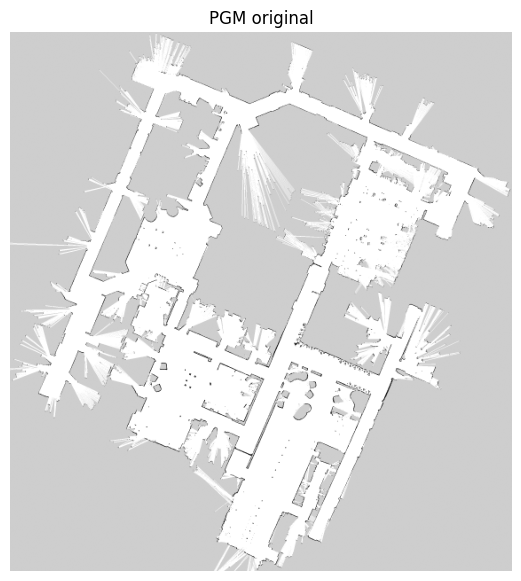

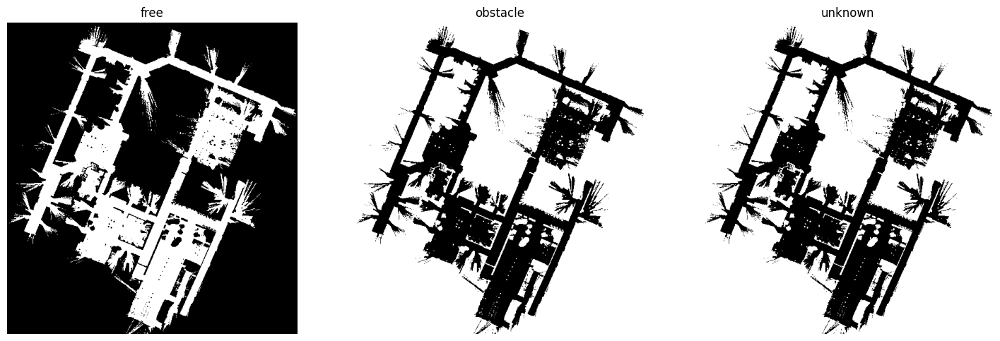

{'free': {'count_true': 91045, 'count_false': 253083, 'ratio_true': 0.26456725404500653, 'shape': (608, 566), 'dtype': 'bool'}, 'obstacle': {'count_true': 253083, 'count_false': 91045, 'ratio_true': 0.7354327459549935, 'shape': (608, 566), 'dtype': 'bool'}, 'unknown': {'count_true': 252990, 'count_false': 91138, 'ratio_true': 0.7351624976752836, 'shape': (608, 566), 'dtype': 'bool'}}


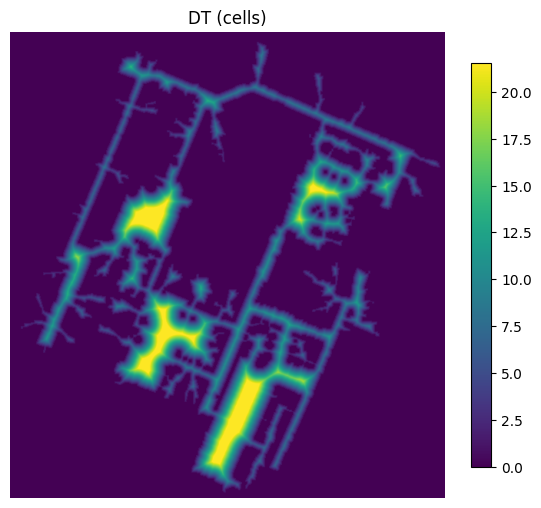

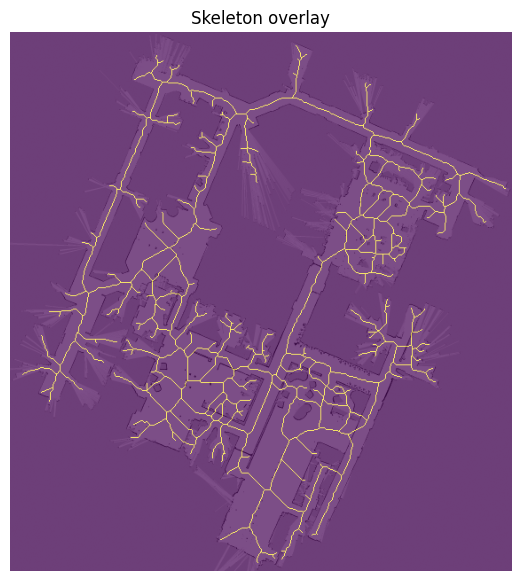

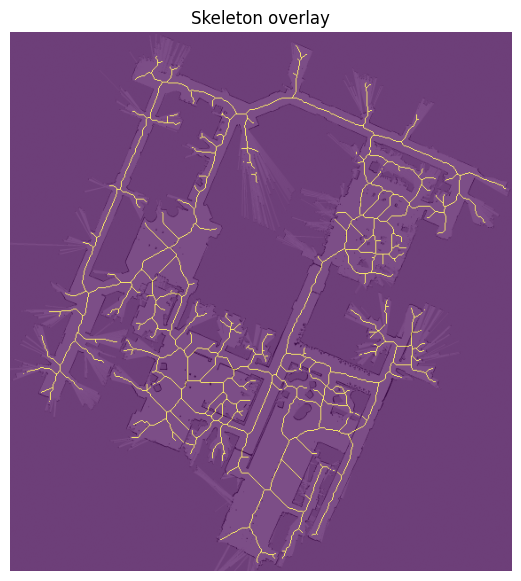

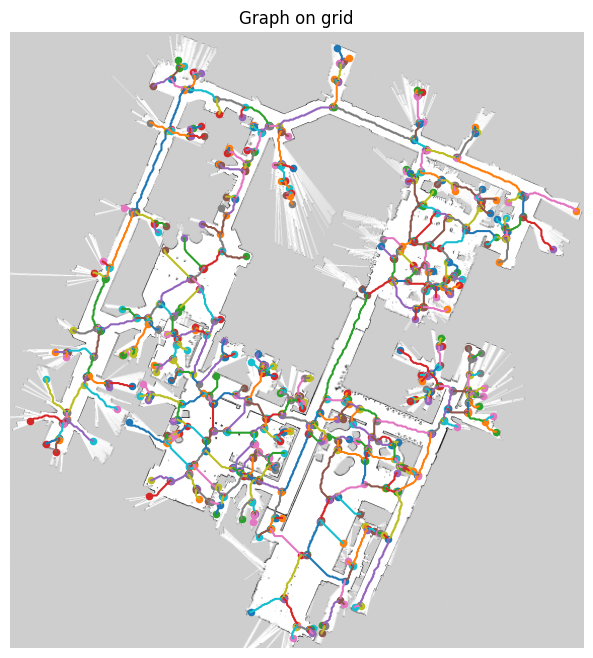

{'nodes': 927, 'edges': 1237, 'avg_degree': 2.668824163969795, 'max_degree': 5, 'min_degree': 1, 'graph_attrs': {'frame_id': 'map', 'resolution_m': 0.05, 'origin_xy_m': (0, 0)}, 'top_nodes_by_degree': [{'id': 'n480', 'deg': 5}, {'id': 'n11', 'deg': 4}, {'id': 'n38', 'deg': 4}, {'id': 'n49', 'deg': 4}, {'id': 'n52', 'deg': 4}, {'id': 'n65', 'deg': 4}, {'id': 'n71', 'deg': 4}, {'id': 'n77', 'deg': 4}, {'id': 'n81', 'deg': 4}, {'id': 'n88', 'deg': 4}]}


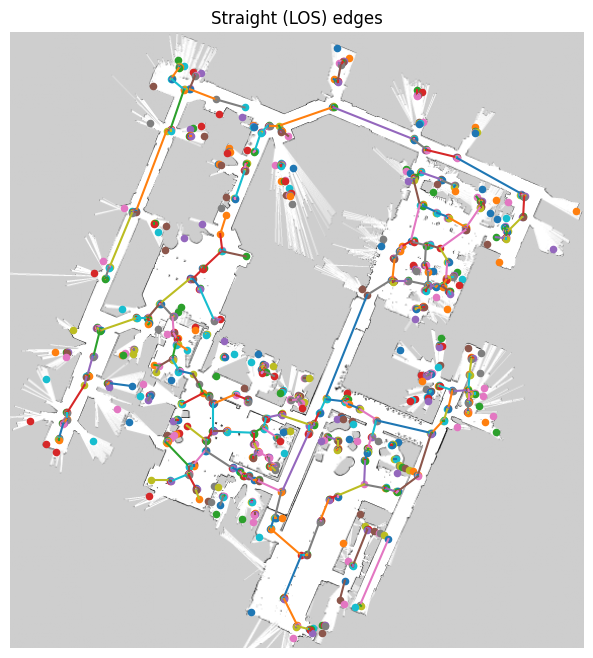

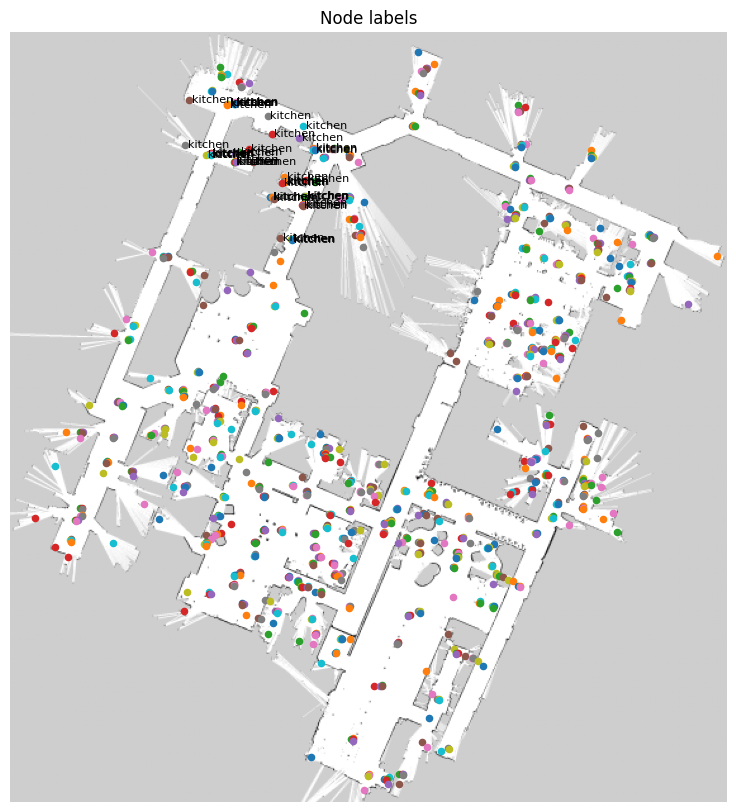

In [11]:
img = load_pgm_gray("willow-2010-02-18-0.10.pgm")

show_gray(img, title="PGM original")

masks = pgm_to_binary_masks(
    img,
    free_threshold=250,      # <-- clave
    occ_threshold=50,
    treat_mid_as_unknown=True,
    unknown_is_obstacle=True
)

known = ~masks["unknown"]
free_known = masks["free"] & known
free_known = clean_free_mask(free_known, open_iters=1, close_iters=1, kernel_size=3)
free_known = keep_largest_component(free_known)
preview_binary_masks(masks)
print(summarize_masks(masks))

dist = compute_distance_transform_l2(free_known, use_precise=True)
show_distance_transform(dist, title="DT (cells)")

skel = compute_skeleton_free_space(free_known)
preview_skeleton(img, skel)

# opcional: filtrar skeleton por holgura mínima
skel = filter_skeleton_by_clearance(skel, dist, min_clearance_cells=2)  # p.ej. 5 celdas
preview_skeleton(img, skel)

G = skeleton_to_nx_graph(skel, resolution_m=0.05, origin_xy_m=(0,0))
preview_graph_nodes_edges_on_grid(img, G, draw_labels=False)
print(summarize_graph(G))

enrich_graph_metrics(G, dist=dist)
mark_edges_line_of_sight(G, free_known, dist=dist, min_clearance_m=0.20)
preview_graph_straight_edges_only(img, G)



rects = [{"label":"kitchen", "start_rc": (50,80), "h": 120, "w": 160}]
label_nodes_by_rectangles(G, rects, label_key="space")
preview_node_labels(img, G, label_key="space")

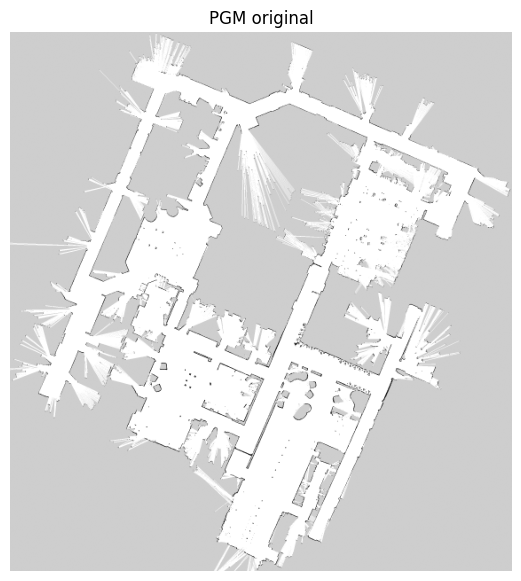

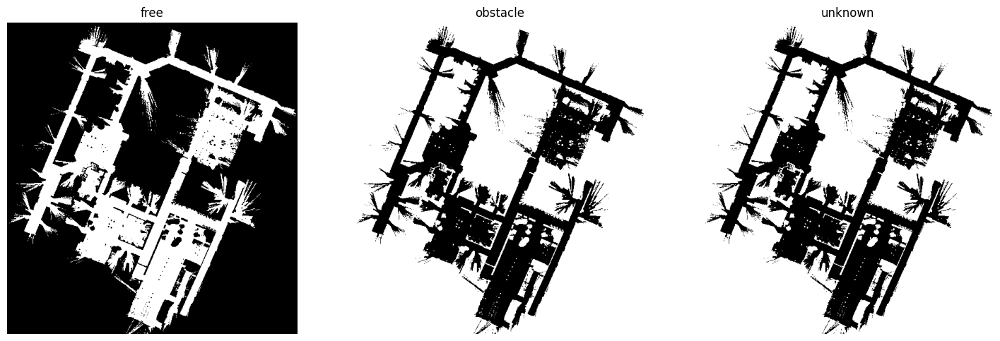

{'free': {'count_true': 91045, 'count_false': 253083, 'ratio_true': 0.26456725404500653, 'shape': (608, 566), 'dtype': 'bool'}, 'obstacle': {'count_true': 253083, 'count_false': 91045, 'ratio_true': 0.7354327459549935, 'shape': (608, 566), 'dtype': 'bool'}, 'unknown': {'count_true': 252990, 'count_false': 91138, 'ratio_true': 0.7351624976752836, 'shape': (608, 566), 'dtype': 'bool'}}


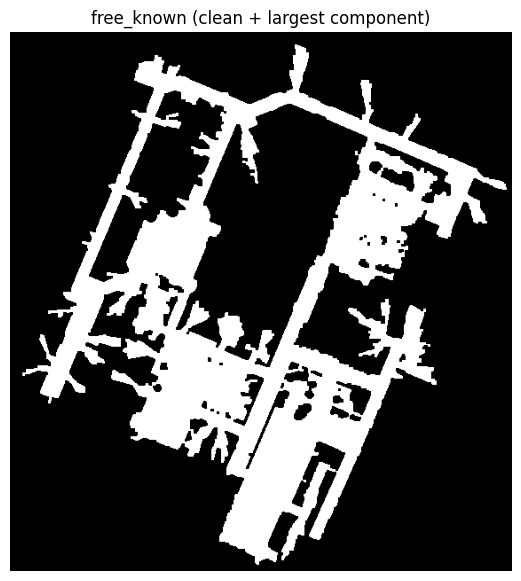

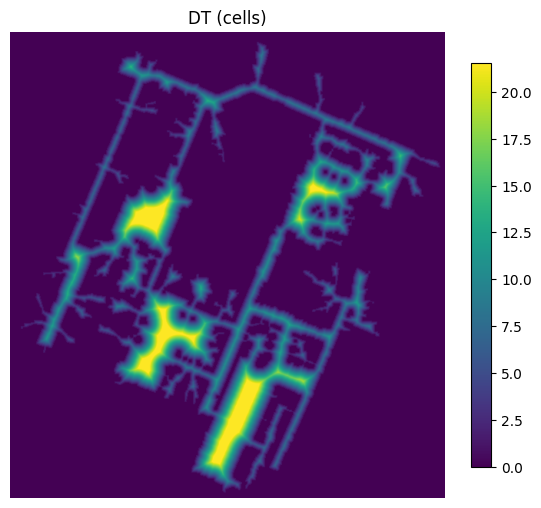

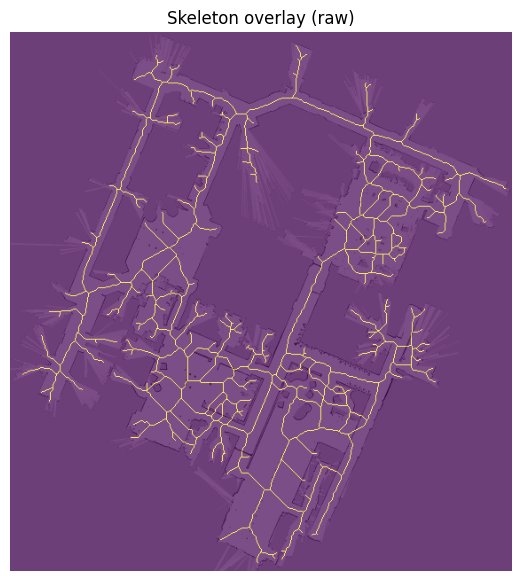

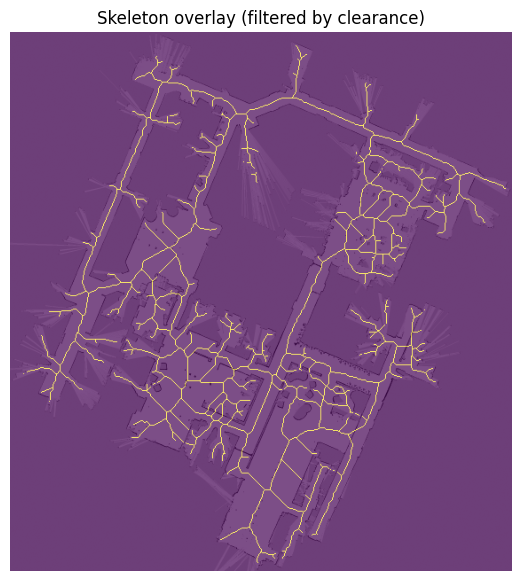

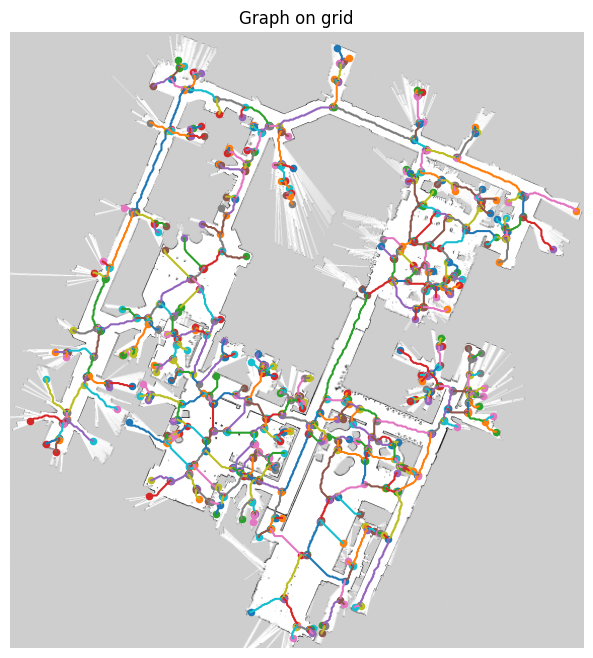

Componentes (topológico): 12
{'nodes': 927, 'edges': 1237, 'avg_degree': 2.668824163969795, 'max_degree': 5, 'min_degree': 1, 'graph_attrs': {'frame_id': 'map', 'resolution_m': 0.05, 'origin_xy_m': (0, 0)}, 'top_nodes_by_degree': [{'id': 'n480', 'deg': 5}, {'id': 'n11', 'deg': 4}, {'id': 'n38', 'deg': 4}, {'id': 'n49', 'deg': 4}, {'id': 'n52', 'deg': 4}, {'id': 'n65', 'deg': 4}, {'id': 'n71', 'deg': 4}, {'id': 'n77', 'deg': 4}, {'id': 'n81', 'deg': 4}, {'id': 'n88', 'deg': 4}]}
Componentes (LOS chain): 12


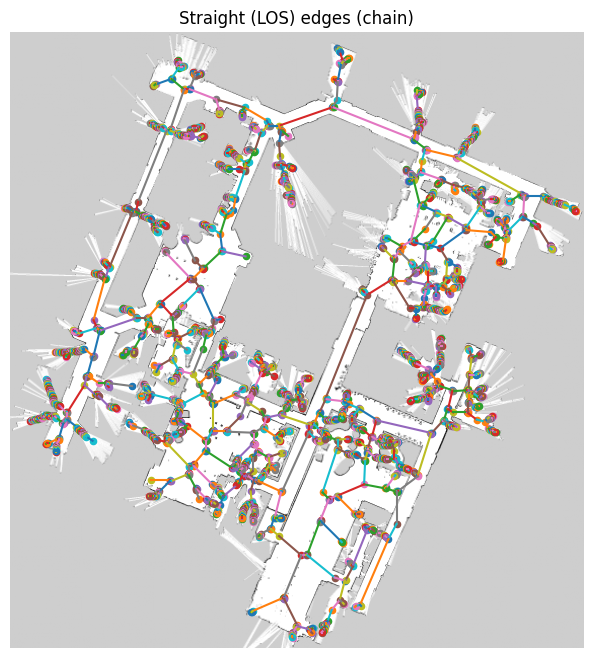

Componentes (LOS + snap): 6


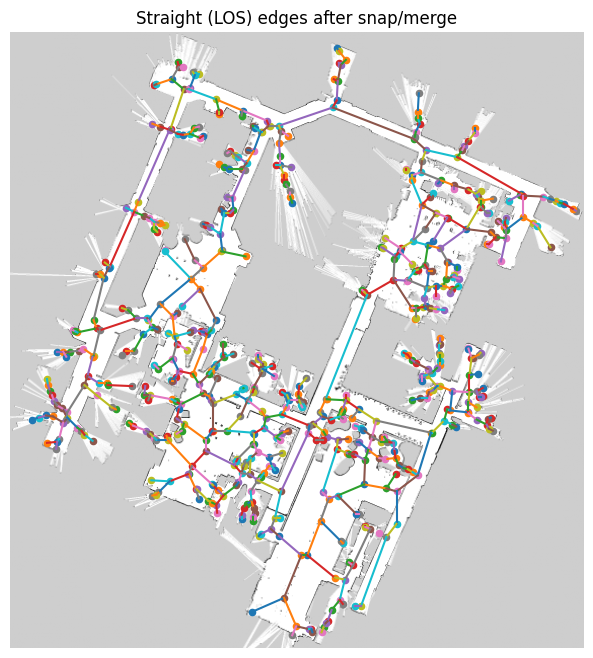

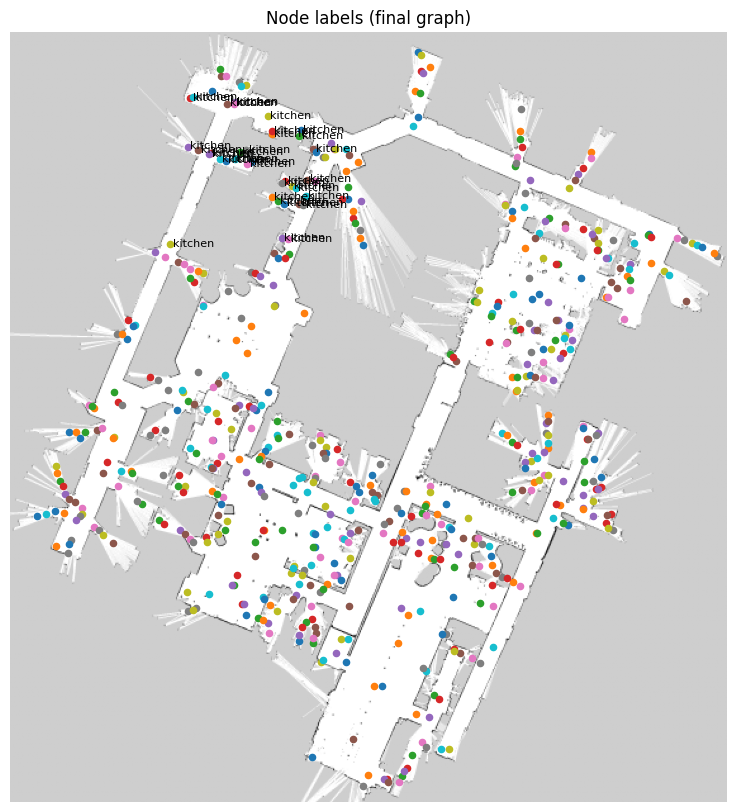

In [16]:
# =========================
# PIPELINE MODIFICADO
# - Mantener conectividad al imponer rectas (LOS) -> reemplazo por CADENA de segmentos LOS
# - Reducir "nubes" de nodos -> snap/merge posterior
# - Mantener holgura como parámetro controlado
# =========================

import numpy as np
import networkx as nx

# --- 0) Carga y sanity check
img = load_pgm_gray("willow-2010-02-18-0.10.pgm")
show_gray(img, title="PGM original")

# --- 1) PGM -> masks (clave: free_threshold alto para no convertir unknown en free)
masks = pgm_to_binary_masks(
    img,
    free_threshold=250,
    occ_threshold=50,
    treat_mid_as_unknown=True,
    unknown_is_obstacle=True
)

preview_binary_masks(masks)
print(summarize_masks(masks))

# --- 2) Restringir al área conocida + limpieza
known = ~masks["unknown"]
free_known = masks["free"] & known

free_known = clean_free_mask(free_known, open_iters=1, close_iters=1, kernel_size=3)
free_known = keep_largest_component(free_known)

show_bool_mask(free_known, title="free_known (clean + largest component)")

# --- 3) Distance Transform sobre el FREE CONOCIDO
dist = compute_distance_transform_l2(free_known, use_precise=True)
show_distance_transform(dist, title="DT (cells)")

# --- 4) Skeleton sobre el FREE CONOCIDO
skel = compute_skeleton_free_space(free_known)
preview_skeleton(img, skel, title="Skeleton overlay (raw)")

# --- 5) (Opcional) Filtrado del skeleton por holgura mínima
# Recomendación: que dependa del robot. Ej. min_clearance_cells = ceil(robot_radius_m / res)
# Aquí lo dejamos en 2 como tú ya estabas probando.
skel = filter_skeleton_by_clearance(skel, dist, min_clearance_cells=2)
preview_skeleton(img, skel, title="Skeleton overlay (filtered by clearance)")

# --- 6) Skeleton -> grafo topológico (conectado)
G_topo = skeleton_to_nx_graph(skel, resolution_m=0.05, origin_xy_m=(0, 0))
preview_graph_nodes_edges_on_grid(img, G_topo, draw_labels=False)
print("Componentes (topológico):", nx.number_connected_components(G_topo))
print(summarize_graph(G_topo))

# --- 7) Métricas sobre aristas topológicas (polilíneas)
enrich_graph_metrics(G_topo, dist=dist)

# --- 8) PASO CLAVE:
# En vez de mark_edges_line_of_sight(G_topo, ...) que rompe conectividad,
# convertimos cada arista en una CADENA de segmentos LOS insertando nodos 'turn'.
G_los = replace_edges_with_los_chains(
    G_topo,
    free_known,
    dist=dist,
    min_clearance_m=0.20  # misma política de seguridad que estabas usando
)

print("Componentes (LOS chain):", nx.number_connected_components(G_los))
preview_graph_straight_edges_only(img, G_los, title="Straight (LOS) edges (chain)")

# --- 9) Reducir "nubes" de nodos: snap/merge
# Ajusta snap_radius_cells si sigues viendo muchos puntos apilados.
G_los_simpl = snap_merge_nodes(G_los, snap_radius_cells=8)

print("Componentes (LOS + snap):", nx.number_connected_components(G_los_simpl))
preview_graph_straight_edges_only(img, G_los_simpl, title="Straight (LOS) edges after snap/merge")

# --- 10) (Opcional recomendado) Recalcular métricas tras simplificación
# Nota: ahora las aristas son segmentos rectos, no path_cells originales.
# Si quieres métricas de longitud, puedes calcularlas desde xy_m.
def enrich_straight_edge_metrics(G: nx.Graph) -> None:
    res = float(G.graph.get("resolution_m", 1.0))
    for u, v, d in G.edges(data=True):
        (x0, y0) = G.nodes[u]["xy_m"]
        (x1, y1) = G.nodes[v]["xy_m"]
        d.setdefault("metrics", {})
        d["metrics"]["length_m"] = float(np.hypot(x1 - x0, y1 - y0))
enrich_straight_edge_metrics(G_los_simpl)

# --- 11) Etiquetado por rectángulos (se aplica sobre el grafo final)
rects = [{"label": "kitchen", "start_rc": (50, 80), "h": 120, "w": 160}]
label_nodes_by_rectangles(G_los_simpl, rects, label_key="space")

preview_node_labels(img, G_los_simpl, label_key="space", title="Node labels (final graph)")

# --- 12) Export JSON para LLM (si lo necesitas)
# json_str = nx_graph_to_llm_json(G_los_simpl)
# print(json_str)


In [ ]:
img = load_pgm_gray("willow-2010-02-18-0.10.pgm")
show_gray(img, title="PGM original")

masks = pgm_to_binary_masks(img)
preview_binary_masks(masks)
print(summarize_masks(masks))

dist = compute_distance_transform_l2(masks["free"])
show_distance_transform(dist, title="DT (cells)")

skel = compute_skeleton_free_space(masks["free"])
preview_skeleton(img, skel)

G = skeleton_to_nx_graph(skel, resolution_m=0.05, origin_xy_m=(0,0))
preview_graph_nodes_edges_on_grid(img, G, draw_labels=False)
print(summarize_graph(G))

enrich_graph_metrics(G, dist=dist)
mark_edges_line_of_sight(G, masks["free"], dist=dist, min_clearance_m=0.20)
preview_graph_straight_edges_only(img, G)

rects = [{"label":"kitchen", "start_rc": (50,80), "h": 120, "w": 160}]
label_nodes_by_rectangles(G, rects, label_key="space")
preview_node_labels(img, G, label_key="space")